<a href="https://colab.research.google.com/github/Anas10202/btt_teamserum/blob/main/btt.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [29]:
import tensorflow as tf
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.applications import EfficientNetB3
from tensorflow.keras.layers import Dense, Flatten, Dropout, GlobalAveragePooling2D, Conv2D, MaxPooling2D, BatchNormalization
from tensorflow.keras.models import Model, Sequential
import numpy as np
import cv2
import matplotlib.pyplot as plt
import os
from sklearn.utils.class_weight import compute_class_weight
import seaborn as sns
import os
import zipfile
import os
import pandas as pd
from PIL import Image
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import LogisticRegression
from sklearn.pipeline import Pipeline
from sklearn.utils import Bunch
from sklearn.metrics import (
    balanced_accuracy_score,
    roc_auc_score,
    accuracy_score,
    recall_score,
    confusion_matrix,
    roc_auc_score,
    roc_curve,
    RocCurveDisplay)
from sklearn import set_config
import random
from sklearn.metrics import confusion_matrix
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.preprocessing import MultiLabelBinarizer
from tensorflow.keras.applications import ResNet50
from tensorflow.keras import models, layers
from sklearn.preprocessing import LabelEncoder
from sklearn.model_selection import train_test_split
from tensorflow.keras.callbacks import EarlyStopping

In [30]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [31]:
zip_path = "/content/drive/MyDrive/BTT_Derm_Files/bttai-ajl-2025.zip"
extract_path = "/content/dataset/BTT_Derm_Files"

# Ensure directory exists before extracting
os.makedirs(extract_path, exist_ok=True)

# Extract ZIP
with zipfile.ZipFile(zip_path, 'r') as zip_ref:
    zip_ref.extractall(extract_path)

print("Done!")

# Load the CSV file
csv_path = "/content/dataset/BTT_Derm_Files/train.csv"
# Load train.csv
train_df = pd.read_csv(csv_path)

# Folder containing the class-specific subfolders
image_folder = '/content/dataset/BTT_Derm_Files/train/train'

# Collect width, height, and aspect ratio, including class information
image_data = []
for class_folder in os.listdir(image_folder):
    class_folder_path = os.path.join(image_folder, class_folder)
    if os.path.isdir(class_folder_path):
        for filename in os.listdir(class_folder_path):
            if filename.endswith(('jpg', 'jpeg', 'png')):
                hash_name = os.path.splitext(filename)[0]  # Extract hash (filename without extension)
                img_path = os.path.join(class_folder_path, filename)

                with Image.open(img_path) as img:
                    width, height = img.size
                    aspect_ratio = width / height
                    image_data.append([hash_name, width, height, aspect_ratio, class_folder])  # Add class folder info

# Create DataFrame with image information
image_df = pd.DataFrame(image_data, columns=['md5hash', 'Width', 'Height', 'Aspect Ratio', 'Class'])
print(image_df.columns)
print(train_df.columns)


# Merge with train.csv
combined_df = train_df.merge(image_df, on='md5hash', how='left')
# Now you can analyze resolutions, plot widths/heights, etc.
print(combined_df.head())

Done!
Index(['md5hash', 'Width', 'Height', 'Aspect Ratio', 'Class'], dtype='object')
Index(['md5hash', 'fitzpatrick_scale', 'fitzpatrick_centaur', 'label',
       'nine_partition_label', 'three_partition_label', 'qc', 'ddi_scale'],
      dtype='object')
                            md5hash  fitzpatrick_scale  fitzpatrick_centaur  \
0  fd06d13de341cc75ad679916c5d7e6a6                  4                    4   
1  a4bb4e5206c4e89a303f470576fc5253                  1                    1   
2  c94ce27e389f96bda998e7c3fa5c4a2e                  5                    5   
3  ebcf2b50dd943c700d4e2b586fcd4425                  3                    3   
4  c77d6c895f05fea73a8f3704307036c0                  1                    1   

                              label nine_partition_label  \
0                 prurigo-nodularis     benign-epidermal   
1  basal-cell-carcinoma-morpheiform  malignant-epidermal   
2                            keloid         inflammatory   
3              basal-cell-carci

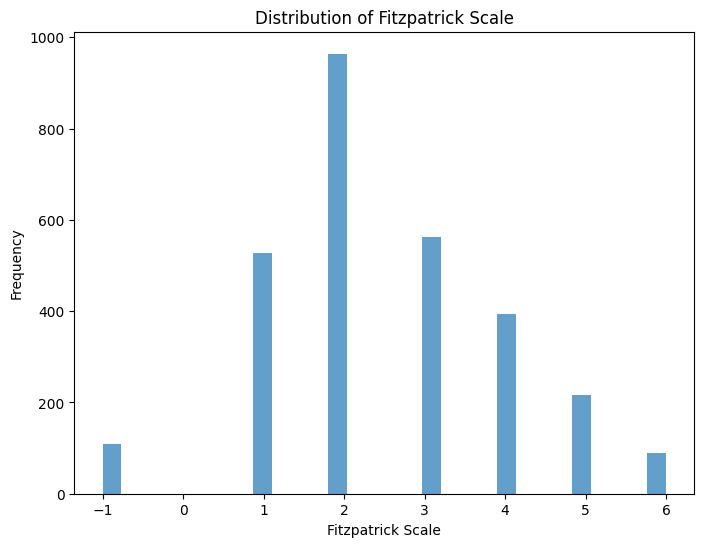

In [32]:
plt.figure(figsize=(8, 6))
plt.hist(combined_df['fitzpatrick_scale'], bins=30, alpha=0.7)
plt.xlabel('Fitzpatrick Scale')
plt.ylabel('Frequency')
plt.title('Distribution of Fitzpatrick Scale')
plt.show()

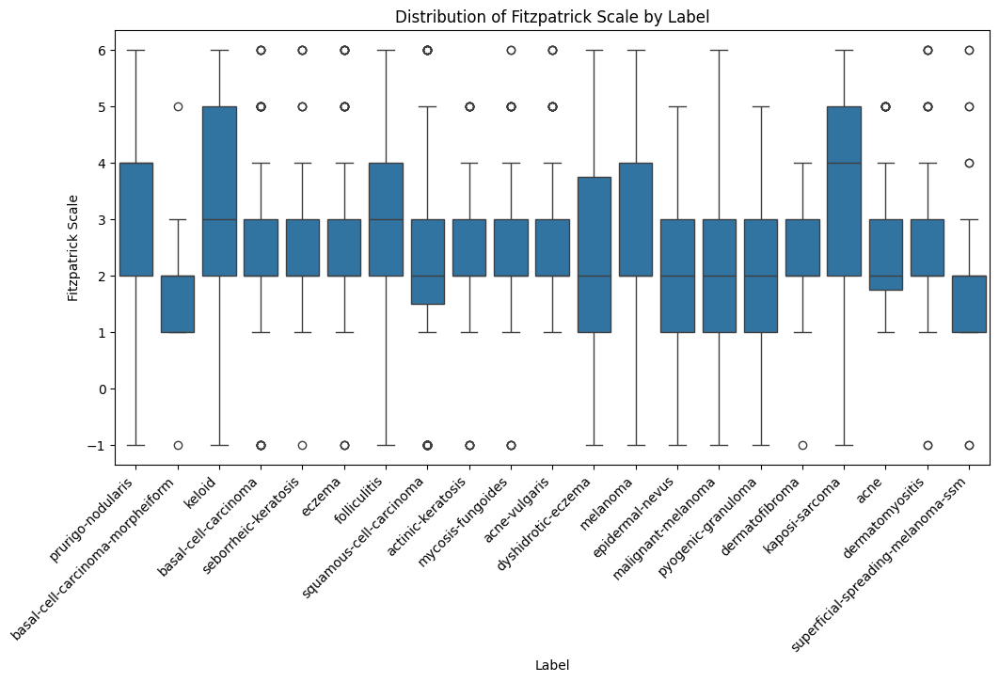

In [33]:
plt.figure(figsize=(12, 6))
sns.boxplot(x=combined_df['label'], y=combined_df['fitzpatrick_scale'])
plt.xticks(rotation=45, ha='right')  # Rotate labels
plt.xlabel('Label')
plt.ylabel('Fitzpatrick Scale')
plt.title('Distribution of Fitzpatrick Scale by Label')
plt.show()

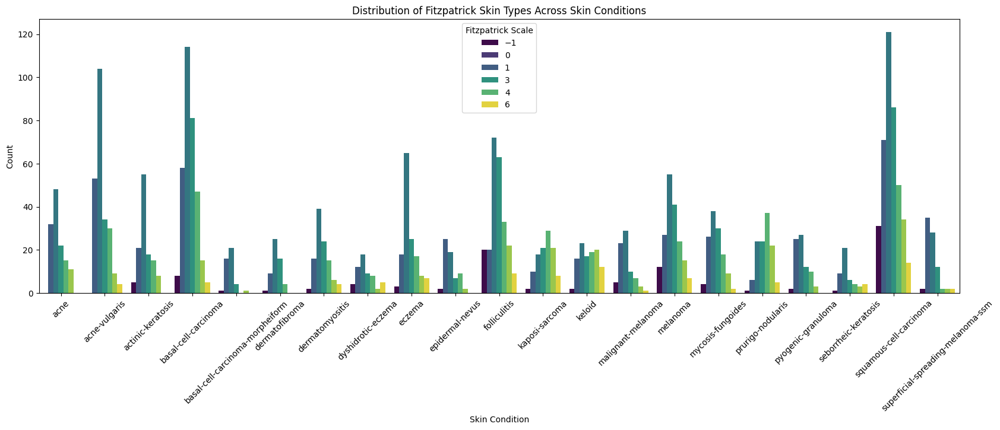

In [34]:
plt.figure(figsize=(20, 6))

df_counts = train_df.groupby(['label', 'fitzpatrick_scale']).size().reset_index(name='count')

sns.barplot(data=df_counts, x='label', y='count', hue='fitzpatrick_scale', palette='viridis')

plt.xlabel("Skin Condition")
plt.ylabel("Count")
plt.title("Distribution of Fitzpatrick Skin Types Across Skin Conditions")
plt.xticks(rotation=45)
plt.legend(title="Fitzpatrick Scale")
plt.show()

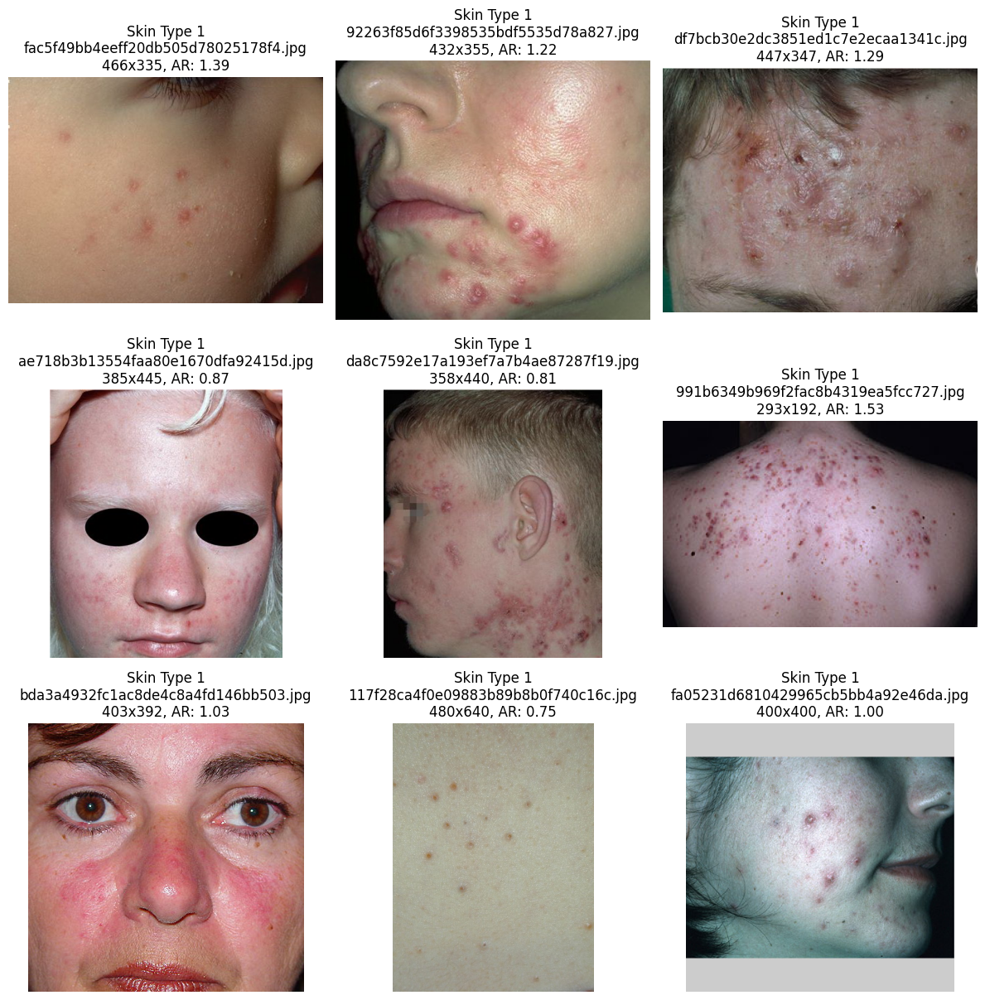

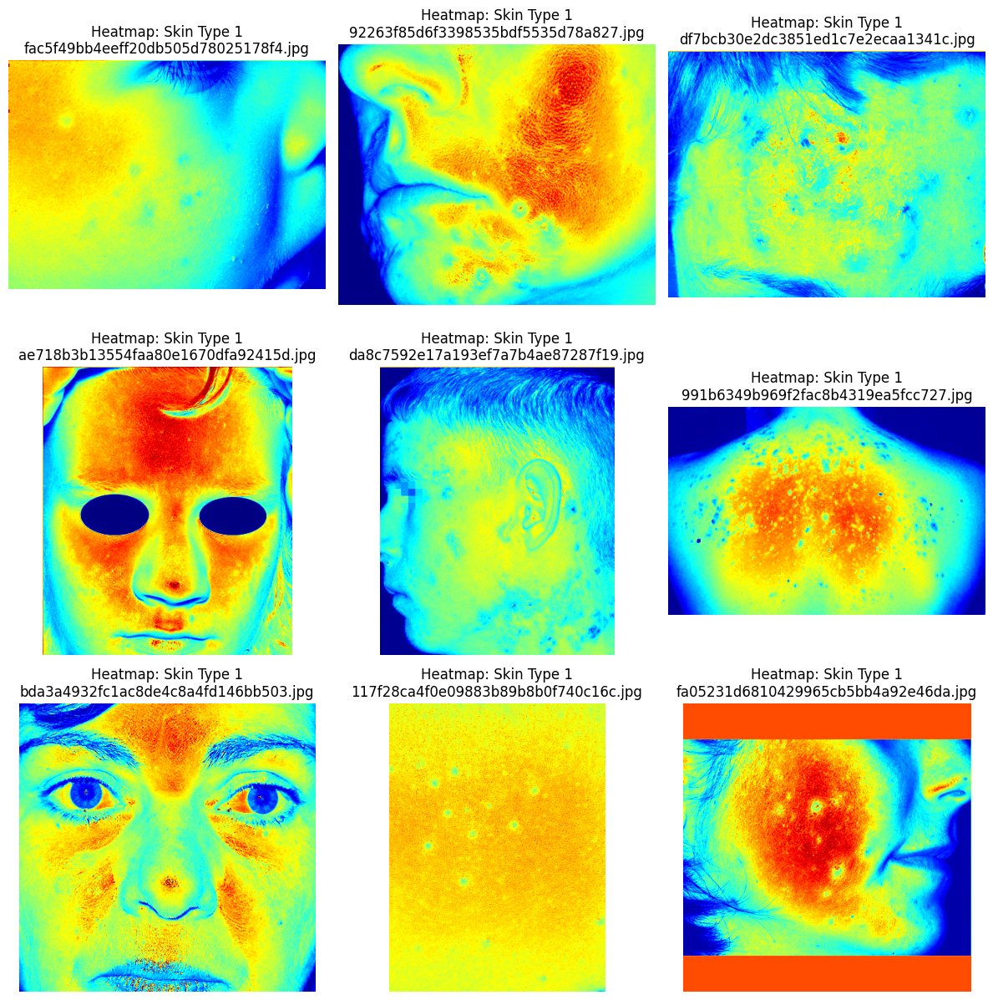

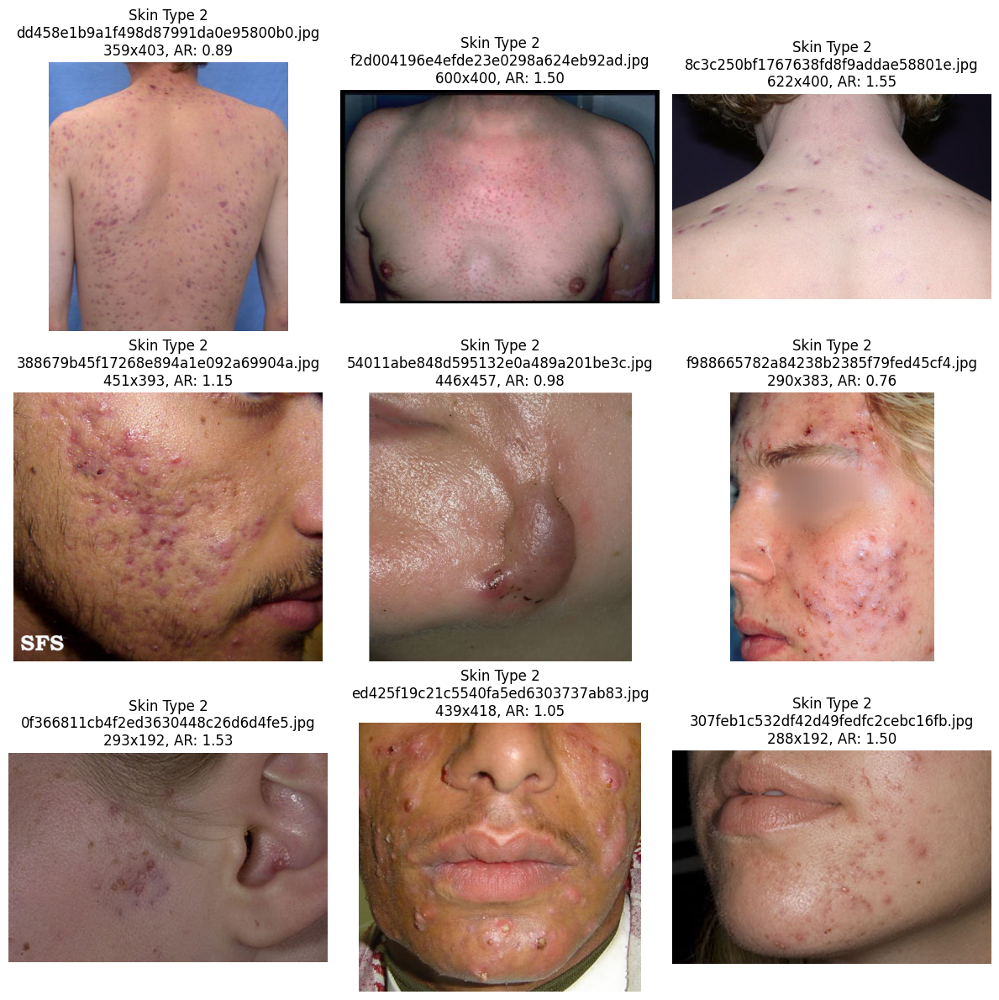

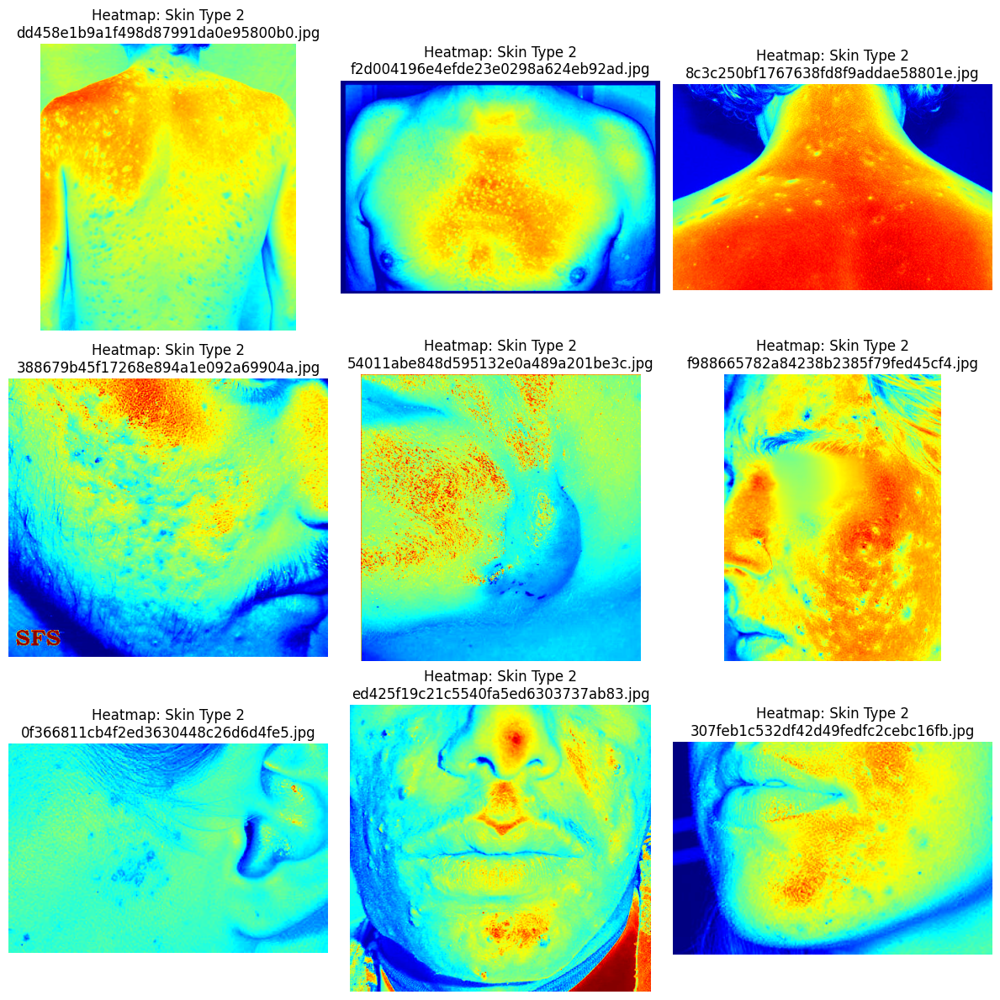

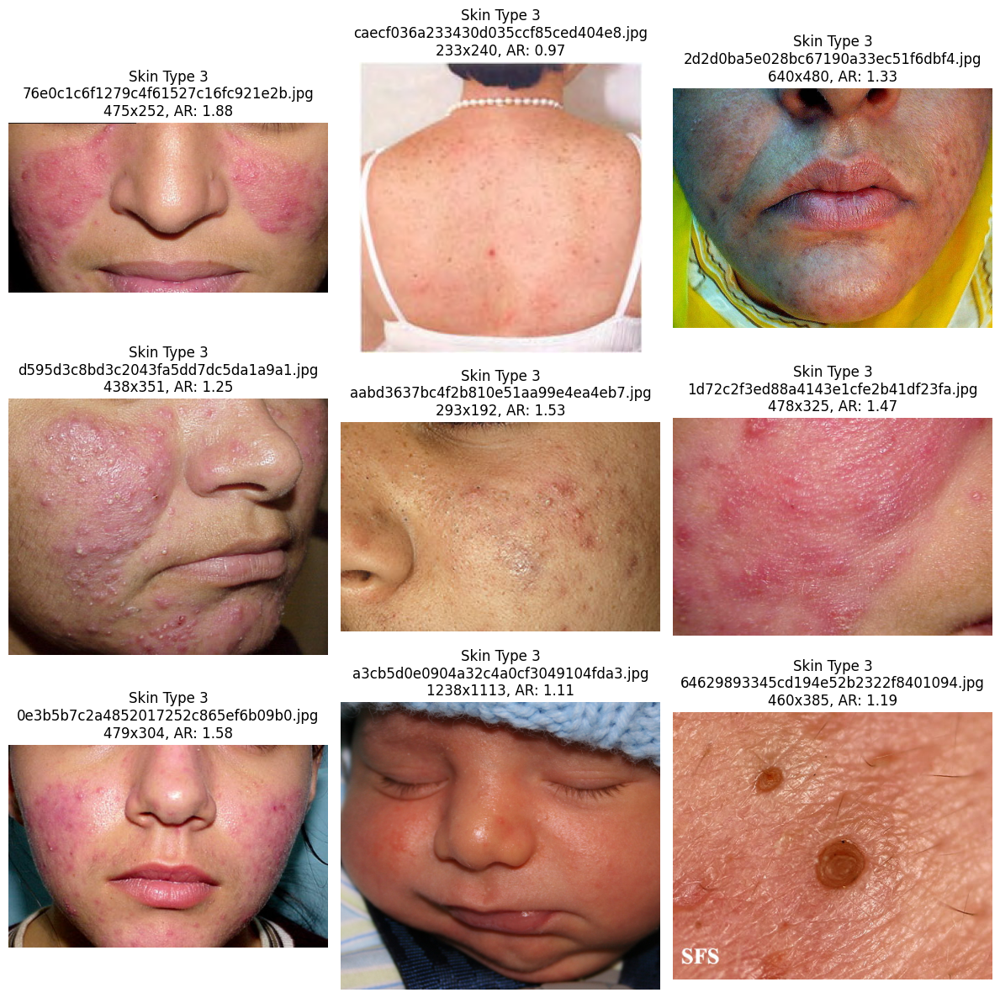

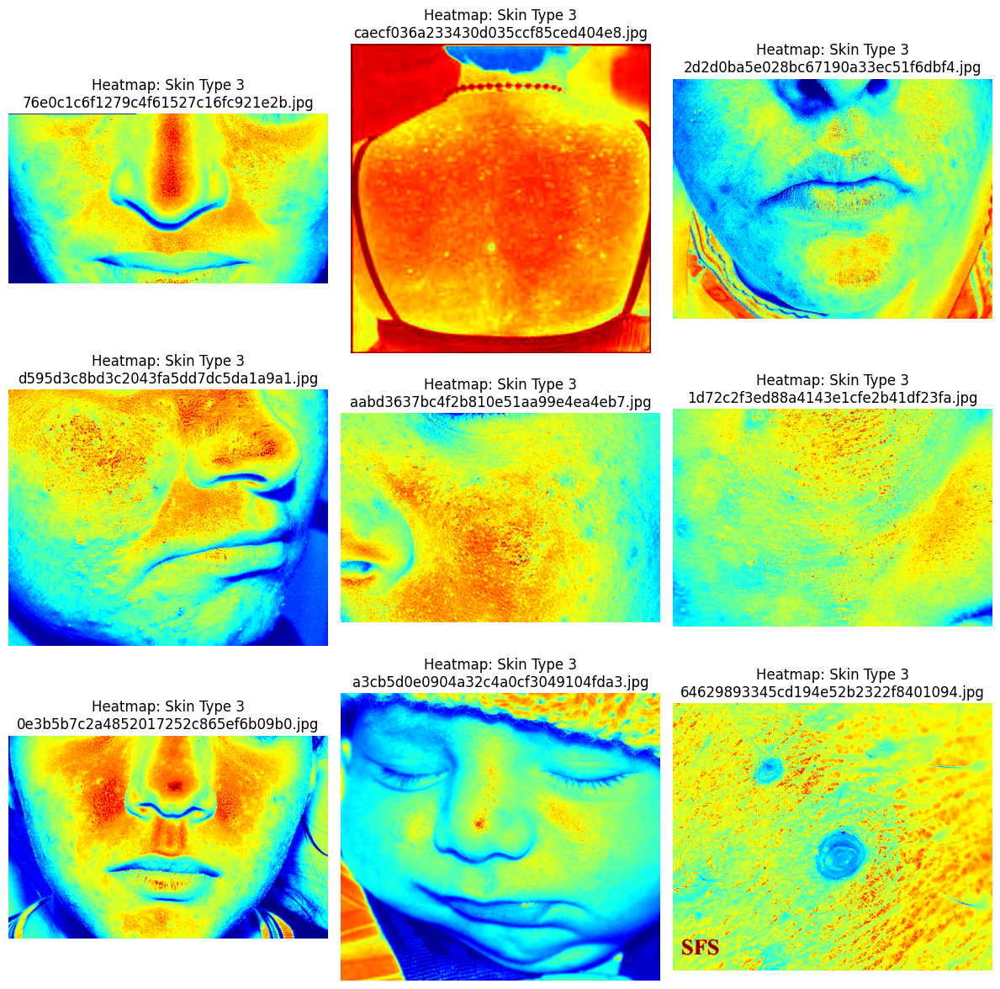

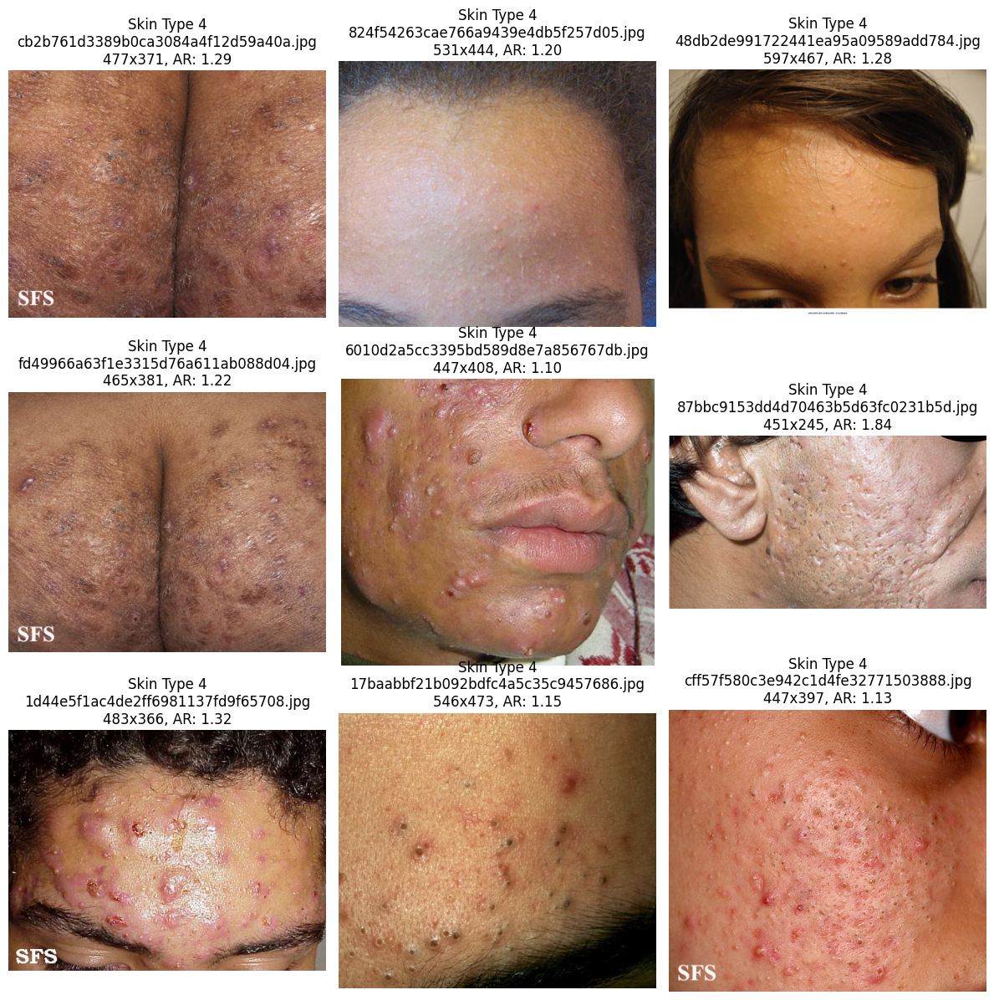

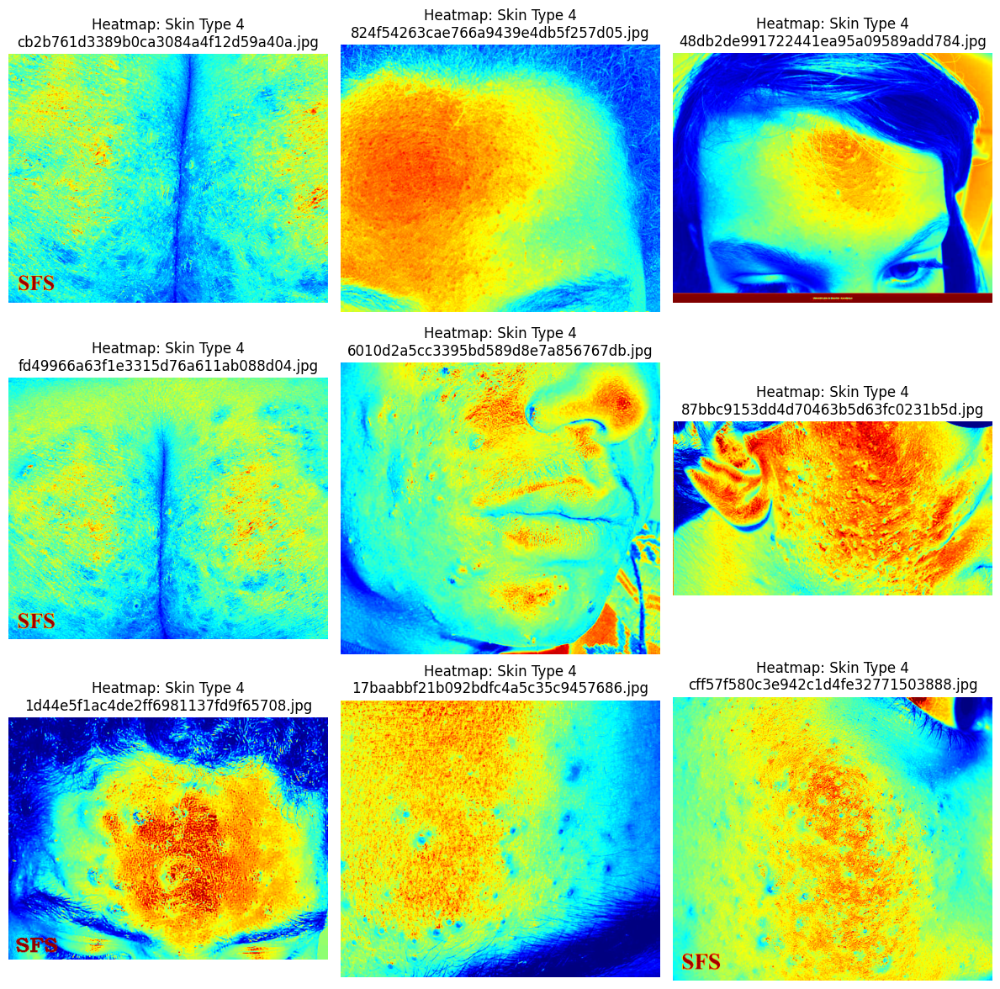

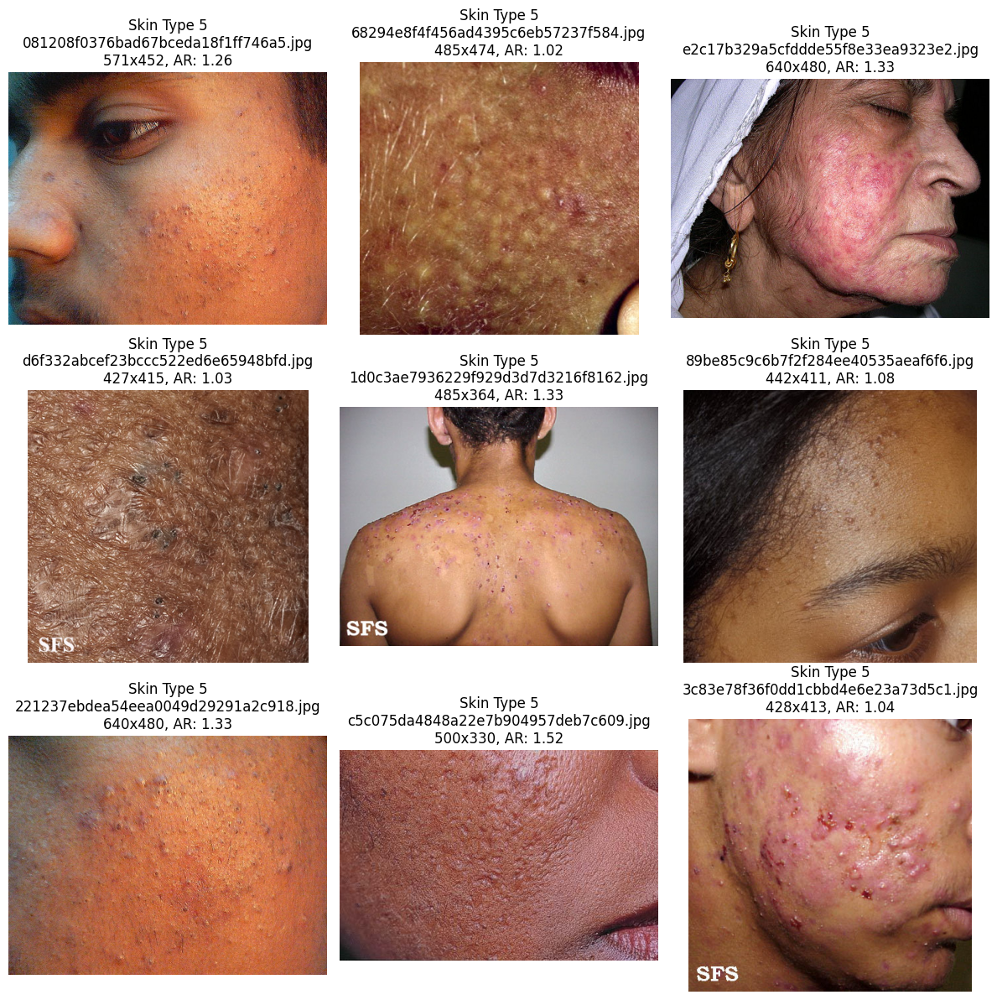

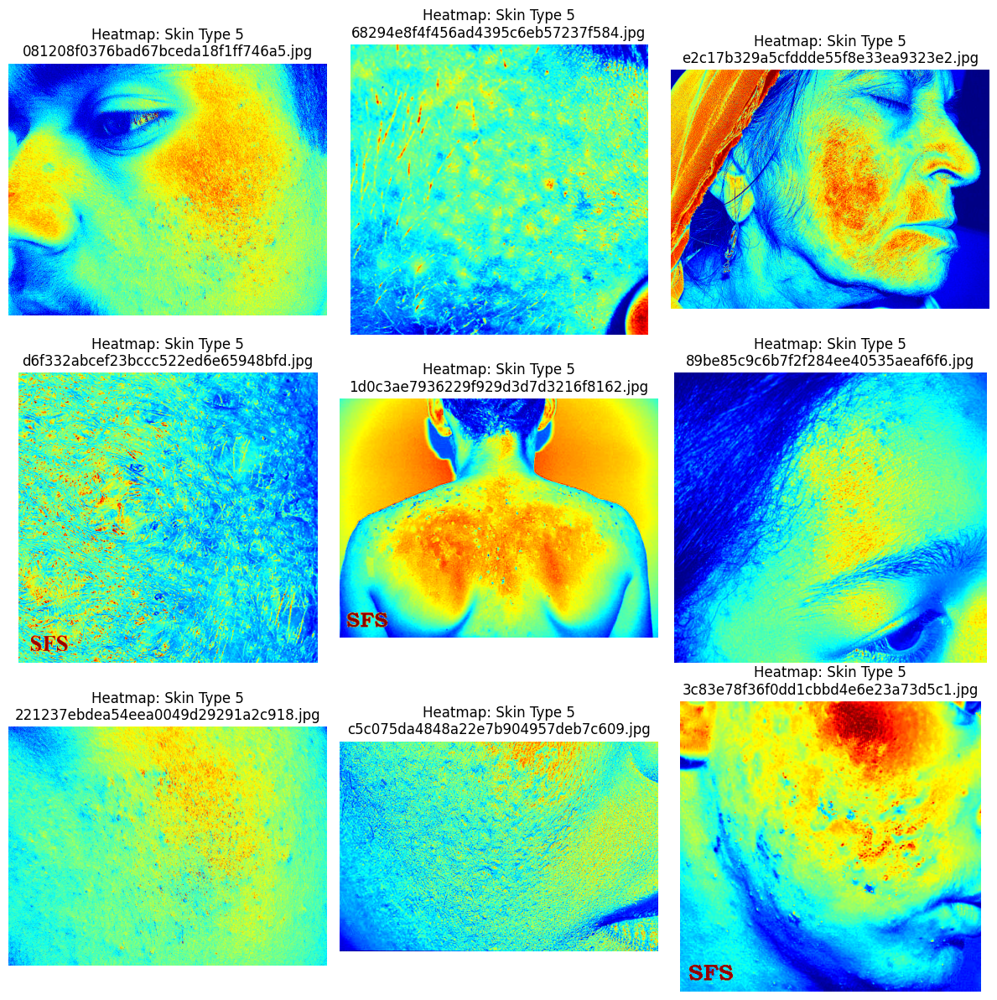

In [35]:
image_folder = '/content/dataset/BTT_Derm_Files/train/train/acne'

fitzpatrick_types = [-1,0,1, 2, 3, 4, 5, 6]

skin_type_images = {t: [] for t in fitzpatrick_types}

for _, row in combined_df.iterrows():
    if row['fitzpatrick_scale'] in fitzpatrick_types:
        image_path = os.path.join(image_folder, row['md5hash'] + '.jpg')
        if os.path.exists(image_path):
            skin_type_images[row['fitzpatrick_scale']].append(image_path)

for skin_type, images in skin_type_images.items():
    if not images:
        continue

    sample_images = random.sample(images, min(9, len(images)))

    plt.figure(figsize=(12, 12))
    for i, img_path in enumerate(sample_images):
        img = Image.open(img_path)
        width, height = img.size
        aspect_ratio = width / height

        plt.subplot(3, 3, i+1)
        plt.imshow(img)
        plt.title(f'Skin Type {skin_type}\n{os.path.basename(img_path)}\n{width}x{height}, AR: {aspect_ratio:.2f}')
        plt.axis('off')

    plt.tight_layout()
    plt.show()

    plt.figure(figsize=(12, 12))
    for i, img_path in enumerate(sample_images):
        img = cv2.imread(img_path)
        img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
        heatmap = cv2.applyColorMap(img, cv2.COLORMAP_JET)

        plt.subplot(3, 3, i+1)
        plt.imshow(cv2.cvtColor(heatmap, cv2.COLOR_BGR2RGB))
        plt.title(f'Heatmap: Skin Type {skin_type}\n{os.path.basename(img_path)}')
        plt.axis('off')

    plt.tight_layout()
    plt.show()



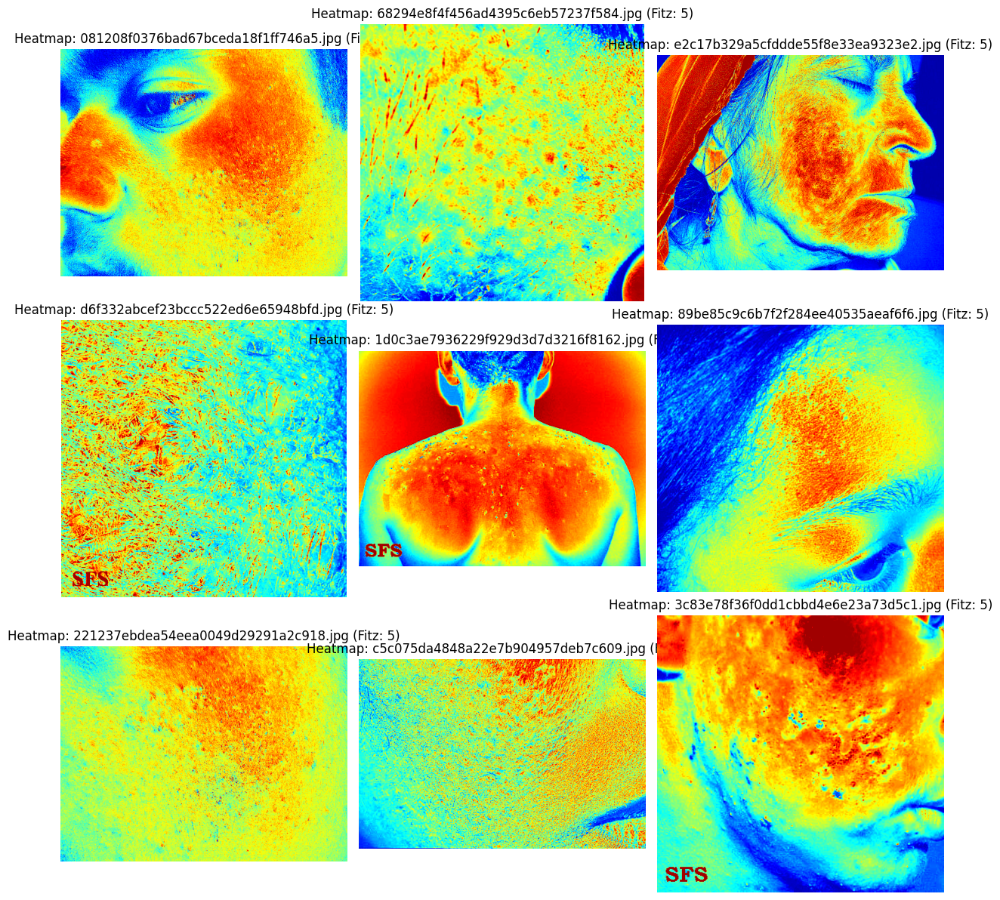

In [36]:
plt.figure(figsize=(12, 12))

for i, img_path in enumerate(sample_images):
    fitzpatrick_type = combined_df[combined_df['md5hash'] == os.path.splitext(os.path.basename(img_path))[0]]['fitzpatrick_scale'].values[0]

    if row['fitzpatrick_scale'] in fitzpatrick_types:  # Ensure skin_type is valid
        image_path = os.path.join(image_folder, row['md5hash'] + '.jpg')
    img = cv2.imread(img_path)

    img_gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

    heatmap = cv2.applyColorMap(img_gray, cv2.COLORMAP_JET)

    if fitzpatrick_type in [5, 6]:
        alpha = 1.2  # Increase contrast
        beta = 10  # Adjust brightness
        enhanced_img = cv2.convertScaleAbs(img, alpha=alpha, beta=beta)

        enhanced_img = cv2.cvtColor(enhanced_img, cv2.COLOR_BGR2LAB)
        enhanced_img[:, :, 1] = np.clip(enhanced_img[:, :, 1] * 1.1, 0, 255)  # A* channel
        enhanced_img[:, :, 2] = np.clip(enhanced_img[:, :, 2] * 1.1, 0, 255)  # B* channel
        enhanced_img = cv2.cvtColor(enhanced_img, cv2.COLOR_LAB2BGR)

        img_gray = cv2.cvtColor(enhanced_img, cv2.COLOR_BGR2GRAY)
        heatmap = cv2.applyColorMap(img_gray, cv2.COLORMAP_JET)

    plt.subplot(3, 3, i+1)
    plt.imshow(cv2.cvtColor(heatmap, cv2.COLOR_BGR2RGB))  # Convert BGR to RGB for correct display
    plt.title(f'Heatmap: {os.path.basename(img_path)} (Fitz: {fitzpatrick_type})')
    plt.axis('off')

plt.tight_layout()
plt.show()

In [37]:
df_qc=combined_df.dropna(subset=["qc"])

In [38]:
df_qc

,md5hash,fitzpatrick_scale,fitzpatrick_centaur,label,nine_partition_label,three_partition_label,qc,ddi_scale,Width,Height,Aspect Ratio,Class
2,c94ce27e389f96bda998e7c3fa5c4a2e,5,5,keloid,inflammatory,non-neoplastic,1 Diagnostic,56,402,359,1.119777,keloid
26,e99ba7397c33ba169192ffdb25b66ccf,5,2,seborrheic-keratosis,benign-epidermal,benign,1 Diagnostic,56,392,431,0.909513,seborrheic-keratosis
75,6be528e219f8ce45c9782e2b05ae3c24,3,2,basal-cell-carcinoma,malignant-epidermal,malignant,1 Diagnostic,34,500,363,1.377410,basal-cell-carcinoma
93,31749f92677e70999c28fe49fbc6dafc,2,2,eczema,inflammatory,non-neoplastic,1 Diagnostic,12,551,427,1.290398,eczema
193,67c9271813f07f5311e2cb435a817403,2,3,basal-cell-carcinoma,malignant-epidermal,malignant,1 Diagnostic,12,485,364,1.332418,basal-cell-carcinoma
...,...,...,...,...,...,...,...,...,...,...,...,...
2745,203f72e12bfd9132ba8f843eaa9a894f,2,1,melanoma,malignant-melanoma,malignant,1 Diagnostic,12,336,291,1.154639,melanoma
2760,802ac1175b149226802b7caab0497857,4,5,keloid,inflammatory,non-neoplastic,1 Diagnostic,34,400,400,1.000000,keloid
2794,4cb85832b363c5ce55d9f52db1157171,4,5,acne-vulgaris,inflammatory,non-neoplastic,1 Diagnostic,34,752,1064,0.706767,acne-vulgaris
2795,af048401c6e99acaba177eef6c43c45c,6,6,squamous-cell-carcinoma,malignant-epidermal,malignant,2 Characteristic,56,507,384,1.320312,squamous-cell-carcinoma


In [39]:
combined_df=combined_df.drop(columns=["ddi_scale","Width","Height","Aspect Ratio"])

In [40]:
# import pandas as pd
# from sklearn.preprocessing import LabelEncoder
# label_encoder = LabelEncoder()
# df_qc['encoded_label'] = label_encoder.fit_transform(df_qc['label'])

In [41]:
# class_labels = np.unique(df_qc['Class'])  # Changed 'classes' to 'Class'
# class_weights = compute_class_weight(
#     class_weight='balanced',
#     classes=class_labels,
#     y=df_qc['Class']  # Changed 'classes' to 'Class'
# )
# class_weights = {i: class_weights[i] for i in range(len(class_weights))}

In [42]:
# from sklearn.utils import resample
# max_count = df_qc["fitzpatrick_scale"].value_counts().max()
# df_balanced = df_qc.groupby("fitzpatrick_scale", group_keys=False).apply(
#     lambda x: resample(x, replace=True, n_samples=max_count, random_state=42)
# )
# df_balanced = df_balanced.sample(frac=1, random_state=42).reset_index(drop=True)  # Shuffle

# # --- Compute Class Weights for Fitzpatrick Scale ---
# class_weights = compute_class_weight(
#     class_weight="balanced",
#     classes=np.unique(df_balanced["fitzpatrick_scale"]),
#     y=df_balanced["fitzpatrick_scale"]
# )
# class_weight_dict = {label: weight for label, weight in zip(np.unique(df_balanced["fitzpatrick_scale"]), class_weights)}


In [43]:
# mlb=MultiLabelBinarizer()
# combined_df['Class'] = combined_df['Class'].astype(str)
# combined_df['fitzpatrick_scale'] =combined_df['fitzpatrick_scale'].astype(str)
# combined_df['combined_labels'] = list(zip(combined_df['Class'], combined_df['fitzpatrick_scale']))
# multi_label_targets = mlb.fit_transform(combined_df['combined_labels'])
# num_classes = len(mlb.classes_)

# print("Unique Labels:", mlb.classes_)
# print("One-hot Encoded Labels Shape:", multi_label_targets.shape)

In [44]:
combined_df['combined_labels'] = combined_df['Class'] + '_fitz' + combined_df['fitzpatrick_scale'].astype(str)

num_unique_labels = combined_df['combined_labels'].nunique()
print("Number of unique labels:", num_unique_labels)

Number of unique labels: 137


In [45]:
label_encoder = LabelEncoder()
combined_df['encoded_labels'] = label_encoder.fit_transform(combined_df['combined_labels'])

# Check the number of unique encoded labels
num_classes = combined_df['encoded_labels'].nunique()
print("Number of unique encoded labels:", num_classes)  # Should be 147

Number of unique encoded labels: 137


In [46]:
from sklearn.utils.class_weight import compute_class_weight
import numpy as np
#Dont need this
# # Get all unique labels from both columns
# all_unique_labels = set(combined_df['Class'].unique()).union(set(combined_df['fitzpatrick_scale'].unique()))

# # Create a mapping from all unique labels to numerical indices
# label_to_index = {label: i for i, label in enumerate(all_unique_labels)}

# # Flatten the labels and convert them to numerical indices
# all_labels_indices = [label_to_index[label] for sublist in combined_df['combined_labels'] for label in sublist]

# Compute class weights using the numerical indices
class_weights = compute_class_weight(
    class_weight="balanced",
    classes=np.unique(combined_df['encoded_labels']),  # Unique encoded labels
    y=combined_df['encoded_labels']  # Use the encoded labels directly
)

# Create the class_weight_dict with numerical indices as keys
class_weight_dict = {i: weight for i, weight in enumerate(class_weights)}

print("Class Weights:", class_weight_dict)

Class Weights: {0: np.float64(0.393885139787908), 1: np.float64(0.20072992700729927), 2: np.float64(0.613997423787033), 3: np.float64(0.6958637469586375), 4: np.float64(2.319545823195458), 5: np.float64(5.218978102189781), 6: np.float64(0.6523722627737226), 7: np.float64(0.4349148418491484), 8: np.float64(0.948905109489051), 9: np.float64(1.391727493917275), 10: np.float64(1.897810218978102), 11: np.float64(4.175182481751825), 12: np.float64(0.9940910670837678), 13: np.float64(0.3795620437956204), 14: np.float64(1.159772911597729), 15: np.float64(1.391727493917275), 16: np.float64(2.6094890510948905), 17: np.float64(20.875912408759124), 18: np.float64(1.3047445255474452), 19: np.float64(0.9940910670837678), 20: np.float64(5.218978102189781), 21: np.float64(20.875912408759124), 22: np.float64(2.6094890510948905), 23: np.float64(0.3599295242889504), 24: np.float64(0.18312203867332566), 25: np.float64(0.25772731368838425), 26: np.float64(0.44416834912253456), 27: np.float64(1.391727493917

In [47]:
from sklearn.utils import resample
image_folder='/content/dataset/BTT_Derm_Files/train/train'
# df_balanced['image_path'] = df_balanced.apply(lambda row: os.path.join(image_folder, row['Class'], row['md5hash'] + '.jpg'), axis=1)
combined_df['image_path'] = combined_df.apply(lambda row: os.path.join(image_folder, row['Class'], row['md5hash'] + '.jpg'), axis=1)

# Get the value counts for each combined label
label_counts = combined_df['combined_labels'].value_counts()
single_sample_labels = label_counts[label_counts == 1].index.tolist()
print("Classes with only 1 sample:", single_sample_labels)

# Oversample classes with only 1 sample
for label in single_sample_labels:
    single_sample = combined_df[combined_df['combined_labels'] == label]
    oversampled_samples = resample(single_sample, replace=True, n_samples=2, random_state=42)
    combined_df = pd.concat([combined_df, oversampled_samples])

# Function to ensure all labels are present in both sets
def ensure_all_labels_in_training(combined_df, test_size=0.2, random_state=42):
    """
    Ensure all labels are present in both the training and validation sets after splitting.
    """
    # Perform the initial split
    df_train, df_val = train_test_split(
        combined_df,
        test_size=test_size,
        random_state=random_state,
        stratify=combined_df['combined_labels']  # Ensure stratified split
    )

    # Check for missing labels in the training and validation sets
    all_labels = set(combined_df['combined_labels'].unique())
    train_labels = set(df_train['combined_labels'].unique())
    val_labels = set(df_val['combined_labels'].unique())
    missing_labels_train = all_labels - train_labels
    missing_labels_val = all_labels - val_labels

    # Add missing labels to the training set
    if missing_labels_train:
        missing_samples_train = [combined_df[combined_df['combined_labels'] == label] for label in missing_labels_train]
        df_train = pd.concat([df_train] + missing_samples_train)

    # Add missing labels to the validation set
    if missing_labels_val:
        missing_samples_val = [combined_df[combined_df['combined_labels'] == label] for label in missing_labels_val]
        df_val = pd.concat([df_val] + missing_samples_val)

    # Shuffle the training and validation sets
    df_train = df_train.sample(frac=1, random_state=random_state).reset_index(drop=True)
    df_val = df_val.sample(frac=1, random_state=random_state).reset_index(drop=True)

    # Verify that all labels are now in both sets
    print("Number of unique labels in training set:", df_train['combined_labels'].nunique())
    print("Number of unique labels in validation set:", df_val['combined_labels'].nunique())

    return df_train, df_val

# Use the function to ensure all labels are in both sets
df_train, df_val = ensure_all_labels_in_training(combined_df)

Classes with only 1 sample: ['malignant-melanoma_fitz6', 'basal-cell-carcinoma-morpheiform_fitz-1', 'seborrheic-keratosis_fitz-1', 'basal-cell-carcinoma-morpheiform_fitz5', 'prurigo-nodularis_fitz-1', 'dermatofibroma_fitz-1']
Number of unique labels in training set: 137
Number of unique labels in validation set: 137


In [48]:
print("Number of unique labels in training set:", df_train['combined_labels'].nunique())
print("Number of unique labels in validation set:", df_val['combined_labels'].nunique())

Number of unique labels in training set: 137
Number of unique labels in validation set: 137


Number of images per encoded label:
encoded_labels
125    121
24     114
1      104
126     86
25      81
      ... 
134      2
135      2
136      2
68       2
34       2
Name: count, Length: 137, dtype: int64


<ipython-input-49-e1a1d1cfe9cc>:13: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=encoded_label_counts.index, y=encoded_label_counts.values, palette="viridis")


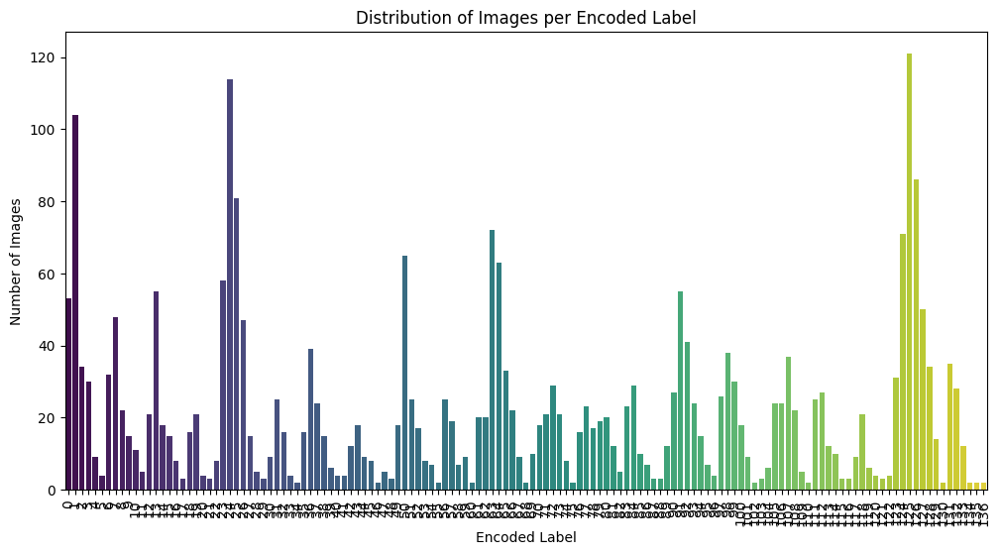

In [49]:
# Count the number of images for each encoded_label
encoded_label_counts = combined_df['encoded_labels'].value_counts()

# Print the counts
print("Number of images per encoded label:")
print(encoded_label_counts)

# Plot the distribution of encoded labels
import matplotlib.pyplot as plt
import seaborn as sns

plt.figure(figsize=(12, 6))
sns.barplot(x=encoded_label_counts.index, y=encoded_label_counts.values, palette="viridis")
plt.xticks(rotation=90)
plt.xlabel("Encoded Label")
plt.ylabel("Number of Images")
plt.title("Distribution of Images per Encoded Label")
plt.show()

In [50]:
# Get all unique labels in combined_df
all_labels_in_combined_df = set(combined_df['encoded_labels'].unique())

# Get labels in the training set
train_labels = set(df_train['encoded_labels'].unique())

# Find missing labels
missing_labels = all_labels_in_combined_df - train_labels
print("Missing labels in training set:", missing_labels)

# Check if missing labels exist in combined_df
for label in missing_labels:
    if label not in all_labels_in_combined_df:
        print(f"Label '{label}' does not exist in combined_df.")

Missing labels in training set: set()


In [51]:
combined_df.head()

,md5hash,fitzpatrick_scale,fitzpatrick_centaur,label,nine_partition_label,three_partition_label,qc,Class,combined_labels,encoded_labels,image_path
0,fd06d13de341cc75ad679916c5d7e6a6,4,4,prurigo-nodularis,benign-epidermal,benign,NaN,prurigo-nodularis,prurigo-nodularis_fitz4,107,/content/dataset/BTT_Derm_Files/train/train/pr...
1,a4bb4e5206c4e89a303f470576fc5253,1,1,basal-cell-carcinoma-morpheiform,malignant-epidermal,malignant,NaN,basal-cell-carcinoma-morpheiform,basal-cell-carcinoma-morpheiform_fitz1,18,/content/dataset/BTT_Derm_Files/train/train/ba...
2,c94ce27e389f96bda998e7c3fa5c4a2e,5,5,keloid,inflammatory,non-neoplastic,1 Diagnostic,keloid,keloid_fitz5,80,/content/dataset/BTT_Derm_Files/train/train/ke...
3,ebcf2b50dd943c700d4e2b586fcd4425,3,3,basal-cell-carcinoma,malignant-epidermal,malignant,NaN,basal-cell-carcinoma,basal-cell-carcinoma_fitz3,25,/content/dataset/BTT_Derm_Files/train/train/ba...
4,c77d6c895f05fea73a8f3704307036c0,1,1,prurigo-nodularis,benign-epidermal,benign,NaN,prurigo-nodularis,prurigo-nodularis_fitz1,104,/content/dataset/BTT_Derm_Files/train/train/pr...


In [52]:
output_csv_path = '/content/combined_df.csv'
combined_df.to_csv(output_csv_path, index=False) # Change output_df to combined_df
print(f"Predictions saved to {output_csv_path}")

Predictions saved to /content/combined_df.csv


In [53]:

# missing_label = 'malignant-melanoma_fitz6'
# print(f"Selected missing label: {missing_label}")

# # Get the image paths for the missing label
# missing_label_samples = combined_df[combined_df['combined_labels'] == missing_label]
# print(f"Number of samples for '{missing_label}': {len(missing_label_samples)}")

# # Display one of the images
# if not missing_label_samples.empty:
#     sample_image_path = missing_label_samples.iloc[0]['image_path']
#     print(f"Image path: {sample_image_path}")

#     # Load and display the image
#     img = Image.open(sample_image_path)
#     plt.figure(figsize=(6, 6))
#     plt.imshow(img)
#     plt.title(f"Label: {missing_label}")
#     plt.axis('off')
#     plt.show()
# else:
#     print(f"No images found for '{missing_label}'.")

In [54]:



datagen = ImageDataGenerator(
    rescale=1./255,
    rotation_range=40,
    width_shift_range=0.2,
    height_shift_range=0.2,
    shear_range=0.2,
    zoom_range=0.2,
    horizontal_flip=True,
    vertical_flip=True,
    brightness_range=[0.8, 1.2],
    fill_mode='nearest'
)
# Create Generators
train_generator = datagen.flow_from_dataframe(
    dataframe=df_train,  # Ensure dataframe has the correct columns
    x_col='image_path',
    y_col='combined_labels',  # or use 'combined_labels' if multi-label
    target_size=(224, 224),  # Adjust to the expected input size
    batch_size=32,
    class_mode='categorical',  # Or 'binary' or 'multi_output' based on your task
    shuffle=True
)


val_gen = datagen.flow_from_dataframe(
    dataframe=df_val,
    x_col='image_path',
    y_col='combined_labels',
    target_size=(224, 224),
    batch_size=32,
    class_mode='categorical',
    shuffle=False
)

# Verify the number of classes in the generators
print("Number of classes in train_generator:", len(train_generator.class_indices))
print("Number of classes in val_gen:", len(val_gen.class_indices))

Found 2297 validated image filenames belonging to 137 classes.
Found 599 validated image filenames belonging to 137 classes.
Number of classes in train_generator: 137
Number of classes in val_gen: 137


In [55]:
print("Number of classes in train_generator:", len(train_generator.class_indices))

Number of classes in train_generator: 137


In [56]:
print("Number of unique labels in combined_df:", combined_df['combined_labels'].nunique())
print("Number of classes in train_generator:", len(train_generator.class_indices))
print("Number of classes in model output layer:", num_classes)

Number of unique labels in combined_df: 137
Number of classes in train_generator: 137
Number of classes in model output layer: 137


In [57]:
# Check for missing labels
all_labels = set(combined_df['combined_labels'].unique())
train_labels = set(df_train['combined_labels'].unique())
missing_labels = all_labels - train_labels

print("Missing labels in training set:", missing_labels)

Missing labels in training set: set()


In [58]:
base_model = ResNet50(weights="imagenet", include_top=False, input_shape=(224, 224, 3))
base_model.trainable = False  # Freeze base model

class_indices = train_generator.class_indices  # {'class1': 0, 'class2': 1, ...}
num_classes = len(class_indices)  # Get the actual number of classes from the generator

# Get the intersection of labels in all_unique_labels and class_indices
# common_labels = list(set(all_unique_labels).intersection(set(class_indices.keys())))

# # Rebuild class_weight_dict using only the common labels and the correct number of classes
# class_weight_dict = {int(class_indices[label]): float(class_weights[i])
#                     for i, label in enumerate(common_labels) if label in class_indices}

#Since we defined the model with the variable `num_classes`, we need to make sure it matches what the generator finds
model = models.Sequential([
    base_model,  # Pre-trained base model (e.g., ResNet, EfficientNet)
    layers.GlobalAveragePooling2D(),  # Global average pooling to reduce spatial dimensions
    layers.Dense(512, activation="relu"),  # First dense layer with 512 units
    layers.BatchNormalization(),  # Batch normalization for stability
    layers.Dropout(0.5),  # Dropout to prevent overfitting
    layers.Dense(256, activation="relu"),  # Second dense layer with 256 units
    layers.BatchNormalization(),  # Batch normalization for stability
    layers.Dropout(0.3),  # Dropout to prevent overfitting
    layers.Dense(num_classes, activation="softmax")  # Output layer with softmax activation
])
print("Corrected Class Weights:", class_weight_dict)

model.compile(
    optimizer="adam",
    loss="categorical_crossentropy",
    metrics=["accuracy"]
)

94765736/94765736 ━━━━━━━━━━━━━━━━━━━━ 1s 0us/step
Corrected Class Weights: {0: np.float64(0.393885139787908), 1: np.float64(0.20072992700729927), 2: np.float64(0.613997423787033), 3: np.float64(0.6958637469586375), 4: np.float64(2.319545823195458), 5: np.float64(5.218978102189781), 6: np.float64(0.6523722627737226), 7: np.float64(0.4349148418491484), 8: np.float64(0.948905109489051), 9: np.float64(1.391727493917275), 10: np.float64(1.897810218978102), 11: np.float64(4.175182481751825), 12: np.float64(0.9940910670837678), 13: np.float64(0.3795620437956204), 14: np.float64(1.159772911597729), 15: np.float64(1.391727493917275), 16: np.float64(2.6094890510948905), 17: np.float64(20.875912408759124), 18: np.float64(1.3047445255474452), 19: np.float64(0.9940910670837678), 20: np.float64(5.218978102189781), 21: np.float64(20.875912408759124), 22: np.float64(2.6094890510948905), 23: np.float64(0.3599295242889504), 24: np.float64(0.18312203867332566), 25: np.float64(0.25772731368838425), 26: n

In [59]:
# from sklearn.utils.class_weight import compute_class_weight
# import numpy as np

# # Flatten the labels (since we're treating it as multi-label classification)
# all_labels = [label for sublist in df_qc['combined_labels'] for label in sublist]

# # Compute class weights
# class_weights = compute_class_weight(
#     class_weight="balanced",
#     classes=np.unique(all_labels),
#     y=all_labels
# )

# # Convert to dictionary
# class_weight_dict = {i: class_weights[i] for i in range(len(class_weights))}

# print("Class Weights:", class_weight_dict)


In [60]:
print(class_weight_dict)

{0: np.float64(0.393885139787908), 1: np.float64(0.20072992700729927), 2: np.float64(0.613997423787033), 3: np.float64(0.6958637469586375), 4: np.float64(2.319545823195458), 5: np.float64(5.218978102189781), 6: np.float64(0.6523722627737226), 7: np.float64(0.4349148418491484), 8: np.float64(0.948905109489051), 9: np.float64(1.391727493917275), 10: np.float64(1.897810218978102), 11: np.float64(4.175182481751825), 12: np.float64(0.9940910670837678), 13: np.float64(0.3795620437956204), 14: np.float64(1.159772911597729), 15: np.float64(1.391727493917275), 16: np.float64(2.6094890510948905), 17: np.float64(20.875912408759124), 18: np.float64(1.3047445255474452), 19: np.float64(0.9940910670837678), 20: np.float64(5.218978102189781), 21: np.float64(20.875912408759124), 22: np.float64(2.6094890510948905), 23: np.float64(0.3599295242889504), 24: np.float64(0.18312203867332566), 25: np.float64(0.25772731368838425), 26: np.float64(0.44416834912253456), 27: np.float64(1.391727493917275), 28: np.fl

In [61]:
print("Number of classes in train_generator:", len(train_generator.class_indices))
print("Number of classes in val_gen:", len(val_gen.class_indices))
print("Number of classes in model output layer:", num_classes)

Number of classes in train_generator: 137
Number of classes in val_gen: 137
Number of classes in model output layer: 137


In [62]:
import tensorflow.keras.backend as K

# # Rebuild class_weight_dict using correct indices
# class_indices = train_generator.class_indices  # {'class1': 0, 'class2': 1, ...}

# # Get the intersection of labels in all_unique_labels and class_indices
# common_labels = list(set(all_unique_labels).intersection(set(class_indices.keys())))

# # Rebuild class_weight_dict using only the common labels
# class_weight_dict = {int(class_indices[label]): float(class_weights[i])
#                     for i, label in enumerate(common_labels) if label in class_indices}

# print("Corrected Class Weights:", class_weight_dict)

def weighted_categorical_crossentropy(class_weight_dict):
    def loss(y_true, y_pred):
        # Ensure weights are created with a float32 dtype
        # Update: Generate weights for each sample in the batch
        sample_weights = K.gather(K.constant(list(class_weight_dict.values()), dtype='float32'), K.argmax(y_true, axis=-1))
        loss = K.categorical_crossentropy(y_true, y_pred)
        weighted_loss = loss * sample_weights  # Element-wise multiplication with sample weights
        return K.mean(weighted_loss)  # Average over the batch
    return loss


model.compile(
    optimizer="adam",
    loss=weighted_categorical_crossentropy(class_weight_dict),  # Pass the class_indices to the loss function
    metrics=["accuracy"]
)

In [63]:
model.fit(
    train_generator,
    class_weight=class_weight_dict,
    validation_data=val_gen,
    epochs=20
)

/usr/local/lib/python3.11/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
72/72 ━━━━━━━━━━━━━━━━━━━━ 544s 7s/step - accuracy: 0.0052 - loss: 8.0542 - val_accuracy: 0.0083 - val_loss: 7.5087
Epoch 2/20
72/72 ━━━━━━━━━━━━━━━━━━━━ 560s 8s/step - accuracy: 0.0130 - loss: 6.5332 - val_accuracy: 0.0033 - val_loss: 7.5422
Epoch 3/20
72/72 ━━━━━━━━━━━━━━━━━━━━ 528s 7s/step - accuracy: 0.0068 - loss: 6.4347 - val_accuracy: 0.0050 - val_loss: 7.4793
Epoch 4/20
72/72 ━━━━━━━━━━━━━━━━━━━━ 556s 8s/step - accuracy: 0.0104 - loss: 6.5173 - val_accuracy: 0.0050 - val_loss: 7.5303
Epoch 5/20
72/72 ━━━━━━━━━━━━━━━━━━━━ 528s 7s/step - accuracy: 0.0095 - loss: 6.1281 - val_accuracy: 0.0050 - val_loss: 8.3648
Epoch 6/20
72/72 ━━━━━━━━━━━━━━━━━━━━ 530s 7s/step - accuracy: 0.0111 - loss: 5.8036 - val_accuracy: 0.0083 - val_loss: 7.9455
Epoch 7/20
72/72 ━━━━━━━━━━━━━━━━━━━━ 522s 7s/step - accuracy: 0.0137 - loss: 6.0995 - val_accuracy: 0.0250 - val_loss: 9.7035
Epoch 8/20
72/72 ━━━━━━━━━━━━━━━━━━━━ 556s 8s/step - accuracy: 0.0078 - loss: 5.9372 - val_accuracy: 0.0067 - v

In [64]:
model.save('res50_before_fine_tuning.h5')

In [65]:
base_model.trainable = True
fine_tune_at = 100  # Unfreeze layers after this index
for layer in base_model.layers[:fine_tune_at]:
    layer.trainable = False

initial_epochs = 20
fine_tune_epochs = 10
total_epochs = initial_epochs + fine_tune_epochs
history = model.fit(
    train_generator,
    class_weight=class_weight_dict,
    validation_data=val_gen,
    epochs=initial_epochs #this will store fit history in 'history'
)





# Define EarlyStopping callback
early_stopping = EarlyStopping(
    monitor='val_loss',  # Monitor validation loss
    patience=5,          # Stop after 5 epochs with no improvement
    restore_best_weights=True  # Restore the best model weights
)

# Train the model with EarlyStopping
history = model.fit(
    train_generator,
    class_weight=class_weight_dict,
    validation_data=val_gen,
    epochs=25,  # Set a higher number of epochs
    callbacks=[early_stopping]  # Add EarlyStopping callback
)


Epoch 1/20
72/72 ━━━━━━━━━━━━━━━━━━━━ 519s 7s/step - accuracy: 0.0114 - loss: 5.5941 - val_accuracy: 0.0000e+00 - val_loss: 10.0812
Epoch 2/20
72/72 ━━━━━━━━━━━━━━━━━━━━ 515s 7s/step - accuracy: 0.0164 - loss: 5.7056 - val_accuracy: 0.0083 - val_loss: 9.1093
Epoch 3/20
72/72 ━━━━━━━━━━━━━━━━━━━━ 549s 8s/step - accuracy: 0.0190 - loss: 4.9715 - val_accuracy: 0.0033 - val_loss: 15.5746
Epoch 4/20
72/72 ━━━━━━━━━━━━━━━━━━━━ 523s 7s/step - accuracy: 0.0189 - loss: 6.2322 - val_accuracy: 0.0083 - val_loss: 8.8628
Epoch 5/20
72/72 ━━━━━━━━━━━━━━━━━━━━ 509s 7s/step - accuracy: 0.0160 - loss: 5.0387 - val_accuracy: 0.0100 - val_loss: 9.8210
Epoch 6/20
72/72 ━━━━━━━━━━━━━━━━━━━━ 508s 7s/step - accuracy: 0.0170 - loss: 5.2591 - val_accuracy: 0.0017 - val_loss: 12.0045
Epoch 7/20
72/72 ━━━━━━━━━━━━━━━━━━━━ 546s 8s/step - accuracy: 0.0168 - loss: 6.1915 - val_accuracy: 0.0083 - val_loss: 11.0737
Epoch 8/20
72/72 ━━━━━━━━━━━━━━━━━━━━ 561s 8s/step - accuracy: 0.0106 - loss: 5.6593 - val_accuracy: 0.

In [66]:
model.save('res50_after_fine_tuning.h5')

In [67]:
val_loss, val_accuracy = model.evaluate(val_gen)
print(f"Validation Loss: {val_loss}, Validation Accuracy: {val_accuracy}")


19/19 ━━━━━━━━━━━━━━━━━━━━ 103s 5s/step - accuracy: 0.0135 - loss: 9.9036
Validation Loss: 9.15445327758789, Validation Accuracy: 0.01001669466495514


In [68]:
# y_true = val_gen.classes
# y_pred = model.predict(val_gen)
# y_pred_classes = (y_pred > 0.5).astype(int)  # Adjust threshold if needed

# # Calculate confusion matrix for multi-label case
# cm = multilabel_confusion_matrix(y_true, y_pred_classes)

# # Assuming you have a limited number of classes for visualization
# num_classes_to_display = min(5, cm.shape[0])  # Display up to 5 classes

# # Plot confusion matrices for selected classes
# fig, axes = plt.subplots(1, num_classes_to_display, figsize=(20, 5))
# for i in range(num_classes_to_display):
#     sns.heatmap(cm[i], annot=True, fmt="d", cmap="Blues", ax=axes[i],
#                 xticklabels=['Not Predicted', 'Predicted'],
#                 yticklabels=['Not True', 'True'])
#     axes[i].set_title(f'Class {mlb.classes_[i]}')  # Assuming mlb is your MultiLabelBinarizer

# plt.tight_layout()
# plt.show()


In [69]:
base_model = EfficientNetB3(weights="imagenet", include_top=False, input_shape=(224, 224, 3))
base_model.trainable = False

model = models.Sequential([
    base_model,  # Pre-trained base model (e.g., ResNet, EfficientNet)
    layers.GlobalAveragePooling2D(),  # Global average pooling to reduce spatial dimensions
    layers.Dense(512, activation="relu"),  # First dense layer with 512 units
    layers.BatchNormalization(),  # Batch normalization for stability
    layers.Dropout(0.5),  # Dropout to prevent overfitting
    layers.Dense(256, activation="relu"),  # Second dense layer with 256 units
    layers.BatchNormalization(),  # Batch normalization for stability
    layers.Dropout(0.3),  # Dropout to prevent overfitting
    layers.Dense(num_classes, activation="softmax")  # Output layer with softmax activation
])

model.compile(
    optimizer="adam",
    loss="categorical_crossentropy",
    metrics=["accuracy"]
)

43941136/43941136 ━━━━━━━━━━━━━━━━━━━━ 0s 0us/step


In [70]:
model.save('Efficient_before.h5')

In [71]:
initial_epochs = 20
history = model.fit(
    train_generator,
    class_weight=class_weight_dict,
    validation_data=val_gen,
    epochs=initial_epochs
)

Epoch 1/20
72/72 ━━━━━━━━━━━━━━━━━━━━ 456s 6s/step - accuracy: 0.0093 - loss: 6.0938 - val_accuracy: 0.0217 - val_loss: 5.1025
Epoch 2/20
72/72 ━━━━━━━━━━━━━━━━━━━━ 429s 6s/step - accuracy: 0.0052 - loss: 5.6082 - val_accuracy: 0.0100 - val_loss: 5.0286
Epoch 3/20
72/72 ━━━━━━━━━━━━━━━━━━━━ 428s 6s/step - accuracy: 0.0037 - loss: 5.8981 - val_accuracy: 0.0100 - val_loss: 5.1111
Epoch 4/20
72/72 ━━━━━━━━━━━━━━━━━━━━ 428s 6s/step - accuracy: 0.0082 - loss: 5.8323 - val_accuracy: 0.0017 - val_loss: 5.1480
Epoch 5/20
72/72 ━━━━━━━━━━━━━━━━━━━━ 425s 6s/step - accuracy: 0.0043 - loss: 5.6220 - val_accuracy: 0.0033 - val_loss: 5.0871
Epoch 6/20
72/72 ━━━━━━━━━━━━━━━━━━━━ 427s 6s/step - accuracy: 0.0018 - loss: 5.8207 - val_accuracy: 0.0017 - val_loss: 5.1444
Epoch 7/20
72/72 ━━━━━━━━━━━━━━━━━━━━ 428s 6s/step - accuracy: 0.0022 - loss: 5.6524 - val_accuracy: 0.0017 - val_loss: 5.0033
Epoch 8/20
72/72 ━━━━━━━━━━━━━━━━━━━━ 483s 7s/step - accuracy: 0.0039 - loss: 5.7546 - val_accuracy: 0.0050 - v

In [ ]:
base_model.trainable = True
fine_tune_at = 100  # Unfreeze layers after this index
for layer in base_model.layers[:fine_tune_at]:
    layer.trainable = False

# Recompile the model with a lower learning rate
model.compile(
    optimizer=tf.keras.optimizers.Adam(1e-5),  # Lower learning rate for fine-tuning
    loss="categorical_crossentropy",
    metrics=["accuracy"]
)

# Continue training
fine_tune_epochs = 10
total_epochs = initial_epochs + fine_tune_epochs
history_fine = model.fit(
    train_generator,
    class_weight=class_weight_dict,
    validation_data=val_gen,
    initial_epoch=history.epoch[-1],
    epochs=total_epochs,
    callbacks=[early_stopping]  # Add early stopping callback if needed
)


Epoch 20/30
72/72 ━━━━━━━━━━━━━━━━━━━━ 867s 11s/step - accuracy: 0.0036 - loss: 5.7941 - val_accuracy: 0.0033 - val_loss: 5.4989
Epoch 21/30
72/72 ━━━━━━━━━━━━━━━━━━━━ 848s 12s/step - accuracy: 0.0019 - loss: 6.0367 - val_accuracy: 0.0067 - val_loss: 5.3132
Epoch 22/30
72/72 ━━━━━━━━━━━━━━━━━━━━ 802s 11s/step - accuracy: 0.0085 - loss: 5.6286 - val_accuracy: 0.0050 - val_loss: 5.4523
Epoch 23/30
72/72 ━━━━━━━━━━━━━━━━━━━━ 786s 11s/step - accuracy: 0.0047 - loss: 5.4328 - val_accuracy: 0.0050 - val_loss: 5.6782
Epoch 24/30
72/72 ━━━━━━━━━━━━━━━━━━━━ 0s 10s/step - accuracy: 0.0045 - loss: 5.8752

In [ ]:
val_loss, val_accuracy = model.evaluate(val_gen)
print(f"Validation Loss: {val_loss}, Validation Accuracy: {val_accuracy}")


In [ ]:
model.save('Efficient_after.h5')

In [ ]:
y_true = val_gen.classes
y_pred = model.predict(val_gen)
y_pred_classes = np.argmax(y_pred, axis=1)  # Convert probabilities to class labels

# Calculate confusion matrix
cm = confusion_matrix(y_true, y_pred_classes)

# Plot confusion matrix
plt.figure(figsize=(10, 8))
sns.heatmap(cm, annot=True, fmt="d", cmap="Blues",
            xticklabels=train_generator.class_indices.keys(),
            yticklabels=train_generator.class_indices.keys())
plt.xlabel('Predicted')
plt.ylabel('True')
plt.title('Confusion Matrix')
plt.show()


old code below

In [ ]:
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.applications import ResNet50
from tensorflow.keras import layers, models

qc_image_paths = []   = []
qc_labels = df_qc['qc'].unique()
for _, row in df_qc.iterrows():
    image_path = os.path.join(image_folder, row['Class'], row['md5hash'] + '.jpg')
    if os.path.exists(image_path):  # Check if image file exists
        qc_image_paths = []  .append(image_path)

def create_data_generator(image_paths, labels, batch_size=32):
    datagen = ImageDataGenerator(rescale=1./255)
    flow = datagen.flow_from_directory(
        image_paths,
        labels,
        target_size=(224, 224),
        batch_size=batch_size,
        class_mode='categorical')  # Or binary for binary classification
    return flow

# Create the pre-trained model with ResNet50 (or any other pre-trained model)
base_model = ResNet50(weights='imagenet', include_top=False, input_shape=(224, 224, 3))

# Freeze the base model layers
base_model.trainable = False

# Add custom classification layers
model = models.Sequential([
    base_model,
    layers.GlobalAveragePooling2D(),
    layers.Dense(1024, activation='relu'),
    layers.Dense(len(qc_labels), activation='softmax')  # Change to the number of QC classes
])

model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])

# Pretrain on QC data
qc_data_gen = create_data_generator(qc_image_paths, qc_labels)
model.fit(qc_data_gen, epochs=10)


In [ ]:
image_folder = '/content/dataset/BTT_Derm_Files/train/train'
all_images = []
for _, row in df_qc.iterrows():
    image_path = os.path.join(image_folder, row['Class'], row['md5hash'] + '.jpg')
    if os.path.exists(image_path):  # Check if image file exists
        all_images.append(image_path)

# Random sample
sample_images = random.sample(all_images, min(9, len(all_images)))  # Ensure sample size doesn't exceed available images

plt.figure(figsize=(12, 12))

for i, img_path in enumerate(sample_images):
    img = Image.open(img_path)
    width, height = img.size
    aspect_ratio = width / height

    plt.subplot(3, 3, i+1)
    plt.imshow(img)
    plt.title(f'{os.path.basename(img_path)}\n{width}x{height}, AR: {aspect_ratio:.2f}')
    plt.axis('off')

plt.tight_layout()
plt.show()

plt.figure(figsize=(12, 12))

for i, img_path in enumerate(sample_images):
    # Load image using OpenCV
    img = cv2.imread(img_path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)  # Convert to grayscale

    # Apply False Coloring (Heatmap)
    heatmap = cv2.applyColorMap(img, cv2.COLORMAP_JET)

    plt.subplot(3, 3, i+1)
    plt.imshow(cv2.cvtColor(heatmap, cv2.COLOR_BGR2RGB))  # Convert BGR to RGB for correct display
    plt.title(f'Heatmap: {os.path.basename(img_path)}')
    plt.axis('off')

plt.tight_layout()
plt.show()


In [ ]:
plt.figure(figsize=(12, 12))

for i, img_path in enumerate(sample_images):
    # Get the Fitzpatrick type from the original DataFrame (df_qc)
    fitzpatrick_type = df_qc[df_qc['md5hash'] == os.path.splitext(os.path.basename(img_path))[0]]['fitzpatrick_scale'].values[0]

    img = cv2.imread(img_path)

    # Convert to grayscale
    img_gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

    # Apply False Coloring (Heatmap)
    heatmap = cv2.applyColorMap(img_gray, cv2.COLORMAP_JET)

    # Adjust for darker skin tones (Fitzpatrick 4,5,6)
    if fitzpatrick_type in [5, 6]:
        alpha = 1.2  # Increase contrast
        beta = 10  # Adjust brightness
        enhanced_img = cv2.convertScaleAbs(img, alpha=alpha, beta=beta)

        # Convert to LAB color space and adjust A/B channels
        enhanced_img = cv2.cvtColor(enhanced_img, cv2.COLOR_BGR2LAB)
        enhanced_img[:, :, 1] = np.clip(enhanced_img[:, :, 1] * 1.1, 0, 255)  # A* channel
        enhanced_img[:, :, 2] = np.clip(enhanced_img[:, :, 2] * 1.1, 0, 255)  # B* channel
        enhanced_img = cv2.cvtColor(enhanced_img, cv2.COLOR_LAB2BGR)

        # Apply False Coloring (Heatmap) to Enhanced Image
        img_gray = cv2.cvtColor(enhanced_img, cv2.COLOR_BGR2GRAY)
        heatmap = cv2.applyColorMap(img_gray, cv2.COLORMAP_JET)

    plt.subplot(3, 3, i+1)
    plt.imshow(cv2.cvtColor(heatmap, cv2.COLOR_BGR2RGB))  # Convert BGR to RGB for correct display
    plt.title(f'Heatmap: {os.path.basename(img_path)} (Fitz: {fitzpatrick_type})')
    plt.axis('off')

plt.tight_layout()
plt.show()


In [ ]:
import tensorflow as tf
from tensorflow.keras.preprocessing.image import ImageDataGenerator
import numpy as np
import pandas as pd
import os

# Load the saved model
model_path = '/content/res50_before_fine_tuning.h5'
model = tf.keras.models.load_model(model_path)

# Verify the model is loaded correctly
model.summary()

# Prepare the test dataset
test_csv_path = '/content/dataset/BTT_Derm_Files/test.csv'  # Path to your test CSV file
test_image_folder = '/content/dataset/BTT_Derm_Files/test/test'  # Path to your test images

# Load the test CSV file
test_df = pd.read_csv(test_csv_path)

# Add image paths to the test dataframe
test_df['image_path'] = test_df.apply(lambda row: os.path.join(test_image_folder, row['md5hash'] + '.jpg'), axis=1)

# Create an ImageDataGenerator for the test data
test_datagen = ImageDataGenerator(rescale=1./255)  # Only rescale, no augmentation

# Create a test generator
test_generator = test_datagen.flow_from_dataframe(
    dataframe=test_df,
    x_col='image_path',
    y_col=None,  # No labels for test data
    target_size=(224, 224),  # Resize images to match model input size
    batch_size=32,
    class_mode=None,  # No labels for test data
    shuffle=False  # Do not shuffle test data
)

# Evaluate the model on the test dataset (if labels are available)
# Note: If your test dataset has labels, you can evaluate the model.
# Otherwise, skip this step and proceed to predictions.

# Example: If test labels are available in a column called 'combined_labels'
if 'combined_labels' in test_df.columns:
    # Create a generator with labels
    test_generator_with_labels = test_datagen.flow_from_dataframe(
        dataframe=test_df,
        x_col='image_path',
        y_col='combined_labels',
        target_size=(224, 224),
        batch_size=32,
        class_mode='categorical',
        shuffle=False
    )

    # Evaluate the model
    test_loss, test_accuracy = model.evaluate(test_generator_with_labels)
    print(f"Test Loss: {test_loss}")
    print(f"Test Accuracy: {test_accuracy}")

# Make predictions on the test dataset
predictions = model.predict(test_generator)

# Convert predictions to class labels
predicted_classes = np.argmax(predictions, axis=1)

# Map predicted classes to class names (if available)
if hasattr(test_generator, 'class_indices'):
    class_indices = test_generator.class_indices
    class_names = list(class_indices.keys())
    predicted_class_names = [class_names[i] for i in predicted_classes]

    # Add predicted class names to the test dataframe
    test_df['predicted_class'] = predicted_class_names

# Save the predictions to a CSV file
output_csv_path = '/content/test_predictions.csv'
test_df.to_csv(output_csv_path, index=False)
print(f"Predictions saved to {output_csv_path}")

In [ ]:
import tensorflow as tf
from tensorflow.keras.preprocessing.image import ImageDataGenerator
import numpy as np
import pandas as pd
import os

# Load the saved model
model_path = '/content/res50_before_fine_tuning.h5'
model = tf.keras.models.load_model(model_path)

# Verify the model is loaded correctly
model.summary()

# Prepare the test dataset
test_csv_path = '/content/dataset/BTT_Derm_Files/test.csv'  # Path to your test CSV file
test_image_folder = '/content/dataset/BTT_Derm_Files/test/test'  # Path to your test images

# Load the test CSV file
test_df = pd.read_csv(test_csv_path)

# Add image paths to the test dataframe
test_df['image_path'] = test_df.apply(lambda row: os.path.join(test_image_folder, row['md5hash'] + '.jpg'), axis=1)

# Create an ImageDataGenerator for the test data
test_datagen = ImageDataGenerator(rescale=1./255)  # Only rescale, no augmentation

# Create a test generator
test_generator = test_datagen.flow_from_dataframe(
    dataframe=test_df,
    x_col='image_path',
    y_col=None,  # No labels for test data
    target_size=(224, 224),  # Resize images to match model input size
    batch_size=32,
    class_mode=None,  # No labels for test data
    shuffle=False  # Do not shuffle test data
)

# Make predictions on the test dataset
predictions = model.predict(test_generator)

# Convert predictions to class labels
predicted_classes = np.argmax(predictions, axis=1)

# Map predicted classes to class names (if available)
if hasattr(test_generator, 'class_indices'):
    class_indices = test_generator.class_indices
    class_names = list(class_indices.keys())
    predicted_class_names = [class_names[i] for i in predicted_classes]
else:
    # If class_indices is not available, use the predicted class indices directly
    predicted_class_names = predicted_classes

# Create a new DataFrame with only the required columns
output_df = pd.DataFrame({
    'image_filename': test_df['md5hash'] + '.jpg',  # Image filename
    'true_label': test_df['combined_labels'],  # True label (if available)
    'predicted_label': predicted_class_names  # Predicted label
})

# Save the predictions to a CSV file
output_csv_path = '/content/test_predictions.csv'
output_df.to_csv(output_csv_path, index=False)
print(f"Predictions saved to {output_csv_path}")

In [ ]:
import h5py

# Open the saved model file
model_path = '/content/res50_before_fine_tuning.h5'
with h5py.File(model_path, 'r') as f:
    # Print the layer names in the saved model
    print("Layers in the saved model:")
    for layer_name in f['model_weights']:
        print(layer_name)

In [ ]:
import tensorflow as tf
from tensorflow.keras.applications import ResNet50
from tensorflow.keras import layers, models
from tensorflow.keras.preprocessing.image import ImageDataGenerator
import numpy as np
import pandas as pd
import os

# Step 1: Define the Model Architecture
# Replace `num_classes` with the actual number of classes in your dataset
num_classes = 137  # Example: Update this based on your dataset

# Define the base model (ResNet50)
base_model = ResNet50(weights="imagenet", include_top=False, input_shape=(224, 224, 3))
base_model.trainable = False

# Define the model architecture
model = models.Sequential([
    base_model,
    layers.GlobalAveragePooling2D(),
    layers.Dense(512, activation="relu"),  # dense
    layers.BatchNormalization(),  # batch_normalization
    layers.Dropout(0.5),  # dropout
    layers.Dense(256, activation="relu"),  # dense_1
    layers.BatchNormalization(),  # batch_normalization_1
    layers.Dropout(0.3),  # dropout_1
    layers.Dense(num_classes, activation="softmax")  # dense_2 (output layer)
])

# Step 2: Load the Weights
model_path = '/content/res50_before_fine_tuning.h5'
model.load_weights(model_path)

# Step 3: Compile the Model
model.compile(
    optimizer="adam",
    loss="categorical_crossentropy",
    metrics=["accuracy"]
)

# Step 4: Prepare the Test Dataset
test_csv_path = '/content/dataset/BTT_Derm_Files/test.csv'  # Path to your test CSV file
test_image_folder = '/content/dataset/BTT_Derm_Files/test/test'  # Path to your test images

# Load the test CSV file
test_df = pd.read_csv(test_csv_path)

# Add image paths to the test dataframe
test_df['image_path'] = test_df.apply(lambda row: os.path.join(test_image_folder, row['md5hash'] + '.jpg'), axis=1)

# Create an ImageDataGenerator for the test data
test_datagen = ImageDataGenerator(rescale=1./255)  # Only rescale, no augmentation

# Create a test generator
test_generator = test_datagen.flow_from_dataframe(
    dataframe=test_df,
    x_col='image_path',
    y_col=None,  # No labels for test data
    target_size=(224, 224),  # Resize images to match model input size
    batch_size=32,
    class_mode=None,  # No labels for test data
    shuffle=False  # Do not shuffle test data
)

# Step 5: Make Predictions on the Test Dataset
predictions = model.predict(test_generator)

# Convert predictions to class labels
predicted_classes = np.argmax(predictions, axis=1)

# Map predicted classes to class names (if available)
if hasattr(test_generator, 'class_indices'):
    class_indices = test_generator.class_indices
    class_names = list(class_indices.keys())
    predicted_class_names = [class_names[i] for i in predicted_classes]
else:
    # If class_indices is not available, use the predicted class indices directly
    predicted_class_names = predicted_classes

# Step 6: Save Predictions to a CSV File
# Create a new DataFrame with only the required columns
output_df = pd.DataFrame({
    'image_filename': test_df['md5hash'] + '.jpg',  # Image filename
    'predicted_label': predicted_class_names  # Predicted label
})

# Save the predictions to a CSV file
output_csv_path = '/content/test_predictions.csv'
output_df.to_csv(output_csv_path, index=False)
print(f"Predictions saved to {output_csv_path}")

In [ ]:
import pandas as pd

# Path to the CSV file
csv_path = '/content/test_predictions.csv'

# Read the CSV file into a DataFrame
df = pd.read_csv(csv_path)

# Display the first few rows
print(df.head())

In [ ]:
import pandas as pd
import json

# Step 1: Load the CSV file with encoded predictions
input_csv_path = '/content/test_predictions.csv'  # Path to your input CSV file
df = pd.read_csv(input_csv_path)

# Display the first few rows of the input CSV
print("Input CSV (encoded predictions):")
print(df.head())

# Step 2: Load the label mapping (e.g., class_indices.json)
label_mapping_path = '/content/class_indices.json'  # Path to your saved label mapping
with open(label_mapping_path, 'r') as f:
    class_indices = json.load(f)

# Reverse the mapping to get {encoded_label: class_name}
index_to_class = {v: k for k, v in class_indices.items()}

# Step 3: Decode the predicted labels
df['predicted_label'] = df['predicted_label'].map(index_to_class)

# Display the first few rows of the updated DataFrame
print("\nDecoded predictions:")
print(df.head())

# Step 4: Extract only the skin class (optional)
# If the class names include Fitzpatrick scale (e.g., "prurigo-nodularis_fitz4"),
# you can extract only the skin class (e.g., "prurigo-nodularis").
df['skin_class'] = df['predicted_label'].apply(lambda x: x.split('_fitz')[0])

# Display the first few rows with the skin class
print("\nPredictions with skin class:")
print(df.head())

# Step 5: Match predictions with combined_df
# Load combined_df (assuming it has columns: md5hash, image_path, combined_labels)
combined_df_path = '/content/combined_df.csv'  # Path to your combined_df CSV file
combined_df = pd.read_csv(combined_df_path)

# Merge predictions with combined_df based on image_filename
# Assuming df has a column 'image_filename' and combined_df has a column 'md5hash'
df['md5hash'] = df['image_filename'].apply(lambda x: x.split('.')[0])  # Extract md5hash from image_filename
merged_df = pd.merge(df, combined_df, on='md5hash', how='left')

# Display the first few rows of the merged DataFrame
print("\nMerged DataFrame:")
print(merged_df.head())

# Step 6: Save the updated DataFrame to a new CSV file
output_csv_path = '/content/test_predictions_decoded_with_combined.csv'  # Path to save the decoded predictions with combined data
merged_df.to_csv(output_csv_path, index=False)

print(f"\nDecoded predictions with combined data saved to {output_csv_path}")